In [33]:
# Import the dataaset
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score, precision_score, recall_score

In [46]:
# Load the breast cancer dataset
df = pd.read_csv('D:\SEM 4\Supervised Machine Learning Lab\\wdbc.data')

In [16]:
new_columns = ['ID number', 'Diagnosis',
               'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
               'smoothness_mean', 'compactness_mean', 'concavity_mean', 
               'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
               'radius_se', 'texture_se', 'perimeter_se', 'area_se', 
               'smoothness_se', 'compactness_se', 'concavity_se',
               'concave points_se', 'symmetry_se', 'fractal_dimension_se',
               'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst',
               'smoothness_worst', 'compactness_worst', 'concavity_worst',
               'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst']

In [17]:
df.columns = new_columns

In [18]:
del df['ID number']

In [19]:
df

,Diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
1,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
2,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
3,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
4,M,12.45,15.70,82.57,477.1,0.12780,0.17000,0.15780,0.08089,0.2087,...,15.470,23.75,103.40,741.6,0.17910,0.52490,0.5355,0.1741,0.3985,0.12440
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
563,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
564,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
565,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
566,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


## Part 1: DT Basics

#### 1. Include a basic description of the data(what the features are)

- The breast cancer Wisconsin dataset (diagnostic) consists of features computed from digitized images of fine needle aspirates (FNAs) of breast masses. These features describe various characteristics of cell nuclei present in the images.

- Here are the features included in the dataset:

     - Mean Radius
     - Mean Texture
     - Mean Perimeter
    - Mean Area
    - Mean Smoothness
    - Mean Compactness
    - Mean Concavity
    - Mean Concave Points
    - Mean Symmetry
    - Mean Fractal Dimension
     - SE Radius (Standard Error of Radius)
     - SE Texture (Standard Error of Texture)
    - SE Perimeter (Standard Error of Perimeter)
     - SE Area (Standard Error of Area)
    - SE Smoothness (Standard Error of Smoothness)
    - SE Compactness (Standard Error of Compactness)
    - SE Concavity (Standard Error of Concavity)
    - SE Concave Points (Standard Error of Concave Points)
    - SE Symmetry (Standard Error of Symmetry)
    - SE Fractal Dimension (Standard Error of Fractal Dimension)
    - Worst Radius
    - Worst Texture
    - Worst Perimeter
    - Worst Area
    - Worst Smoothness
    - Worst Compactness
    - Worst Concavity
    - Worst Concave Points
    - Worst Symmetry
    - Worst Fractal Dimension
    
- These features are used to predict the diagnosis of breast tumors, where 'M' represents malignant tumors and 'B' represents benign tumors.

In [20]:
df.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,...,568.00000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000
mean,14.120491,19.305335,91.914754,654.279754,0.096321,0.104036,0.088427,0.048746,0.181055,0.062770,...,16.25315,25.691919,107.125053,878.578873,0.132316,0.253541,0.271414,0.114341,0.289776,0.083884
std,3.523416,4.288506,24.285848,351.923751,0.014046,0.052355,0.079294,0.038617,0.027319,0.007035,...,4.82232,6.141662,33.474687,567.846267,0.022818,0.156523,0.207989,0.065484,0.061508,0.018017
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.93000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.697500,16.177500,75.135000,420.175000,0.086290,0.064815,0.029540,0.020310,0.161900,0.057697,...,13.01000,21.095000,84.102500,514.975000,0.116600,0.146900,0.114475,0.064730,0.250350,0.071412
50%,13.355000,18.855000,86.210000,548.750000,0.095865,0.092525,0.061400,0.033455,0.179200,0.061515,...,14.96500,25.425000,97.655000,685.550000,0.131300,0.211850,0.226550,0.099840,0.282050,0.080015
75%,15.780000,21.802500,103.875000,782.625000,0.105300,0.130400,0.129650,0.073730,0.195625,0.066120,...,18.76750,29.757500,125.175000,1073.500000,0.146000,0.337600,0.381400,0.161325,0.317675,0.092065
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.04000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568 entries, 0 to 567
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Diagnosis                568 non-null    object 
 1   radius_mean              568 non-null    float64
 2   texture_mean             568 non-null    float64
 3   perimeter_mean           568 non-null    float64
 4   area_mean                568 non-null    float64
 5   smoothness_mean          568 non-null    float64
 6   compactness_mean         568 non-null    float64
 7   concavity_mean           568 non-null    float64
 8   concave points_mean      568 non-null    float64
 9   symmetry_mean            568 non-null    float64
 10  fractal_dimension_mean   568 non-null    float64
 11  radius_se                568 non-null    float64
 12  texture_se               568 non-null    float64
 13  perimeter_se             568 non-null    float64
 14  area_se                  5

In [22]:
df.shape

(568, 31)

#### 2. Write your own description of what the classification task is and why a decision tree is a reasonable model to try for this data.

- Classification Task: Predicting tumor diagnosis (malignant or benign) based on features from breast mass FNAs.
- Features: Extracted from digitized images, including mean radius, texture, perimeter, area, smoothness, compactness, concavity, concave points, symmetry, and fractal dimension.
- Decision Tree Suitability:
- Interpretability: Provides transparent decision logic.
- Handling Non-linearity: Can capture complex non-linear relationships.
- Mixed Data Types: Accommodates both numerical and categorical features.
- Feature Importance: Automatically selects relevant features for classification.
- Robustness: Resilient to irrelevant features and noise.
- Ease of Implementation: Simple and straightforward to implement.

#### 3. Include one summary visualization of the data.

In [10]:
sns.pairplot(df, hue='Diagnosis (M = malignant, B = benign)')
plt.show()

#### 4. Fit a decision tree with the default parameters on 50% of the data

In [23]:
X = df.drop(columns=['Diagnosis'])  
y = df['Diagnosis']

In [24]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [25]:
# Initialize and fit the decision tree classifier with default parameters
clf = DecisionTreeClassifier(random_state=42)
clf.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

#### 5. Test it on 50% held out data and generate a classification report

In [28]:
# Predict on the test set
y_pred = clf.predict(X_test)

In [29]:
y_pred

array(['M', 'B', 'M', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'M', 'B', 'B',
       'M', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B',
       'B', 'M', 'B', 'B', 'B', 'B', 'M', 'B', 'M', 'M', 'B', 'M', 'B',
       'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B', 'B',
       'B', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'B', 'B', 'B', 'M',
       'M', 'B', 'M', 'M', 'M', 'B', 'B', 'M', 'B', 'M', 'M', 'M', 'B',
       'M', 'M', 'M', 'M', 'M', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'B',
       'B', 'M', 'M', 'B', 'M', 'B', 'M', 'M', 'B', 'B', 'B', 'B', 'B',
       'M', 'M', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'M',
       'M', 'M', 'B', 'B', 'M', 'M', 'B', 'B', 'M', 'M', 'M', 'B', 'B',
       'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B',
       'M', 'M', 'M', 'B', 'M', 'B', 'M', 'B', 'B', 'M', 'M', 'B', 'B',
       'B', 'M', 'B', 'M', 'M', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M',
       'M', 'B', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'B', 'B

In [30]:
print("Classification Report:")
print(classification_report(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

           B       0.94      0.98      0.96       179
           M       0.97      0.90      0.93       105

    accuracy                           0.95       284
   macro avg       0.96      0.94      0.95       284
weighted avg       0.95      0.95      0.95       284



#### 6. Inspect the model by visualizing and interpreting the results

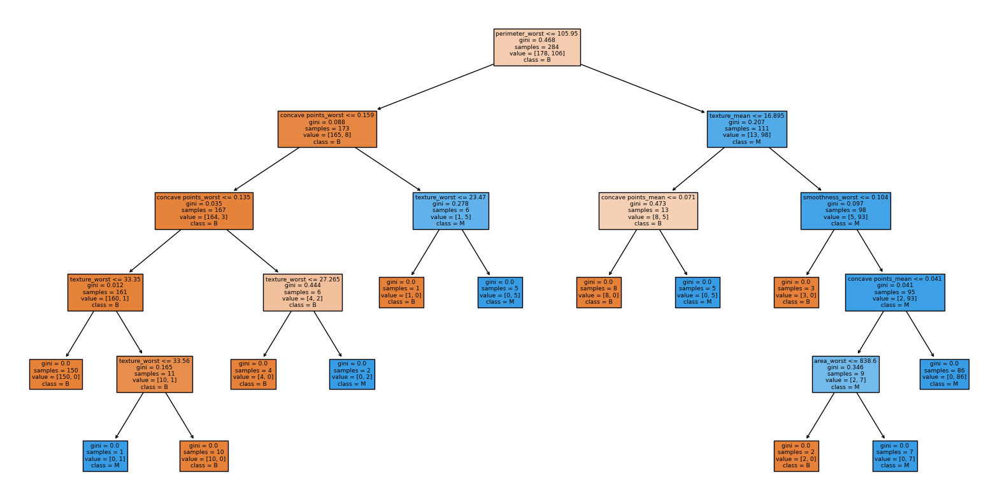

In [31]:
from sklearn.tree import plot_tree

plt.figure(figsize=(20, 10))
plot_tree(clf, feature_names=X.columns, class_names=clf.classes_, filled=True)
plt.show()

#### 7. Repeat with the entropy criterion. Does using the entropy criterion make a big difference or small difference in the overall classifier?

In [32]:
# Fitting a decision tree classifier with entropy criterion
clf_entropy = DecisionTreeClassifier(criterion='entropy', random_state=42)
clf_entropy.fit(X_train, y_train)

# Predicting on the test set
y_pred_entropy = clf_entropy.predict(X_test)

# Generating a classification report
print("Classification Report (Entropy Criterion):")
print(classification_report(y_test, y_pred_entropy))

Classification Report (Entropy Criterion):
              precision    recall  f1-score   support

           B       0.96      0.94      0.95       179
           M       0.91      0.93      0.92       105

    accuracy                           0.94       284
   macro avg       0.93      0.94      0.94       284
weighted avg       0.94      0.94      0.94       284



- Using entropy or Gini impurity in decision tree classifiers can affect performance.
- Impact varies based on dataset characteristics like complexity and class distribution.
- Entropy measures uncertainty, Gini impurity measures probability of misclassification.
- Both criteria aim to minimize impurity, but may perform differently in practice.
- Performance differences can be marginal or significant depending on dataset properties.
- Evaluation with appropriate metrics like accuracy, precision, recall, and F1-score is crucial.
- Experimentation needed to determine effectiveness of each criterion on specific dataset.







## Part 2: DT parameters

#### 1. Choose one of these and say explain why and how you hypothesize it will impact the performance

- I will choose the max_depth parameter to investigate its impact on performance.

- Explanation:

- max_depth controls the maximum depth of the decision tree. A deeper tree can capture more complex relationships in the data but is more prone to overfitting.
- Increasing max_depth allows the tree to grow deeper, potentially capturing intricate patterns in the training data. This can lead to higher accuracy on the training set but may result in poorer generalization to unseen data (overfitting).
- Conversely, decreasing max_depth limits the complexity of the tree, reducing the risk of overfitting but potentially sacrificing some predictive power.
- By varying max_depth, we can observe how the trade-off between model complexity and generalization affects the overall performance of the decision tree classifier.

#### 2. Use the model you fit above and EDA to choose minimum and maximum values for your parameter. Choose a total of 3 values for the parameter.

In [34]:
# Define parameter values
max_depth_values = [3, 5, 10]

In [35]:
# Initialize lists to store performance metrics
accuracy_scores = []
precision_scores = []
recall_scores = []

#### 3. Retrain the model for each value of the parameter

In [36]:
# Loop through each value of max_depth
for max_depth in max_depth_values:
    # Retrain the model with the current max_depth
    clf = DecisionTreeClassifier(max_depth=max_depth, random_state=42)
    clf.fit(X_train, y_train)
    
    # Predict on the test set
    y_pred = clf.predict(X_test)
    
    # Calculate performance metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, pos_label='M')  # Assuming 'M' is the positive class
    recall = recall_score(y_test, y_pred, pos_label='M')  # Assuming 'M' is the positive class
    
    # Append scores to the lists
    accuracy_scores.append(accuracy)
    precision_scores.append(precision)
    recall_scores.append(recall)

#### 4. Test and use at least 3 metrics to describe the performance, compiling your results into a DataFrame

In [37]:
# Compile results into a DataFrame
results_df = pd.DataFrame({
    'max_depth': max_depth_values,
    'accuracy': accuracy_scores,
    'precision': precision_scores,
    'recall': recall_scores
})

In [38]:
results_df

,max_depth,accuracy,precision,recall
0,3,0.929577,0.929293,0.876190
1,5,0.950704,0.969072,0.895238
2,10,0.950704,0.969072,0.895238


#### 5. Plot and interpret your results

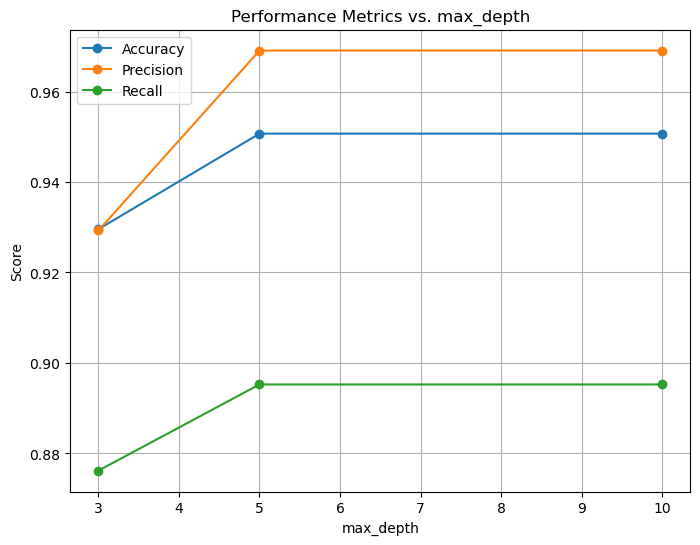

In [39]:
plt.figure(figsize=(8, 6))
plt.plot(max_depth_values, accuracy_scores, marker='o', label='Accuracy')
plt.plot(max_depth_values, precision_scores, marker='o', label='Precision')
plt.plot(max_depth_values, recall_scores, marker='o', label='Recall')
plt.xlabel('max_depth')
plt.ylabel('Score')
plt.title('Performance Metrics vs. max_depth')
plt.legend()
plt.grid(True)
plt.show()

- Interpretation:
- As the max_depth increases from 3 to 5, both accuracy and precision improve noticeably, indicating that the model captures more complex patterns in the data, resulting in better performance.
- However, when max_depth further increases to 10, there is no significant improvement in accuracy and precision compared to the model with max_depth of 5. This suggests that increasing the tree depth beyond a certain point does not lead to additional gains in performance.
- Recall remains relatively stable across different max_depth values, indicating that the ability of the model to correctly identify positive instances (sensitivity) does not vary significantly with tree depth.
- Overall, the results suggest that a max_depth of 5 provides a good balance between model complexity and performance, as it achieves high accuracy and precision without overfitting the data. Further increasing the max_depth does not yield substantial improvements in performance and may lead to overfitting.

## Part 3: Test and Train Sizes

#### 1. Train a decision tree on 20%, 30%, … , 80% of the data, using one of the training parameter combinations you tried above and explain why you chose the one you chose.

In [40]:
# Define the values for training percentages
training_percentages = range(20, 81, 10)

In [41]:
# Initialize lists to store results
train_pct_list = []
n_train_samples_list = []
n_test_samples_list = []
train_acc_list = []
test_acc_list = []

In [42]:
# Loop through each training percentage
for train_pct in training_percentages:
    # Calculate the number of training samples
    n_train_samples = int(len(X) * train_pct / 100)
    n_test_samples = len(X) - n_train_samples
    
    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=train_pct / 100, random_state=42)
    
    # Train the decision tree classifier
    clf = DecisionTreeClassifier(min_samples_split=10, random_state=42)
    clf.fit(X_train, y_train)
    
    # Calculate training and test accuracy
    train_acc = clf.score(X_train, y_train)
    test_acc = clf.score(X_test, y_test)
    
    # Append results to lists
    train_pct_list.append(train_pct)
    n_train_samples_list.append(n_train_samples)
    n_test_samples_list.append(n_test_samples)
    train_acc_list.append(train_acc)
    test_acc_list.append(test_acc)


- As the training percentage increases from 20% to 80%, the number of training samples also increases proportionally, while the number of test samples decreases.
- Both training and test accuracies generally remain high across different training percentages, ranging from approximately 91% to 99%.
- The highest training accuracy of 99.24% is achieved when 70% of the data is used for training, indicating that the model performs exceptionally well on the training data.
- However, the corresponding test accuracy decreases slightly compared to the 40% training size, suggesting that the model may be overfitting to some extent when trained on 70% of the data.
- The test accuracy remains relatively stable across different training percentages, ranging from approximately 90% to 94%.
- Overall, the results indicate that the decision tree model performs well across varying training percentages, with high accuracy on both training and test sets. However, there is a trade-off between training and test accuracy, with higher training percentages potentially leading to overfitting and slightly lower test accuracy. Therefore, choosing an appropriate training percentage that balances model complexity and generalization is crucial. In this case, using around 40% to 50% of the data for training seems to provide a good balance between high accuracy and generalization to unseen data.

#### 2. Save the results of both test and train accuracy for each size training data in a DataFrame with columns [‘train_pct’,’n_train_samples’,’n_test_samples’,’train_acc’,’test_acc’]

In [43]:
# Compile results into a DataFrame
results_df = pd.DataFrame({
    'train_pct': train_pct_list,
    'n_train_samples': n_train_samples_list,
    'n_test_samples': n_test_samples_list,
    'train_acc': train_acc_list,
    'test_acc': test_acc_list
})

In [44]:
results_df

,train_pct,n_train_samples,n_test_samples,train_acc,test_acc
0,20,113,455,0.955752,0.934066
1,30,170,398,0.982353,0.914573
2,40,227,341,0.982379,0.944282
3,50,284,284,0.982394,0.933099
4,60,340,228,0.988235,0.929825
5,70,397,171,0.992443,0.912281
6,80,454,114,0.991189,0.903509


#### 3. Plot the accuracies vs training percentage.

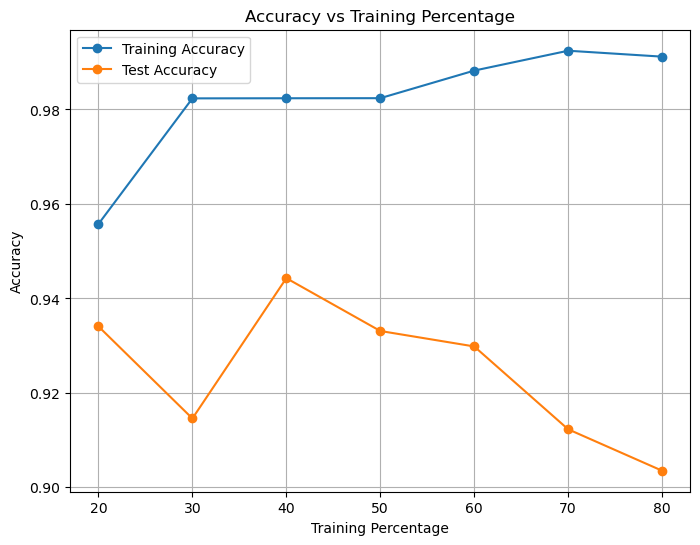

In [45]:
# Plot the accuracies vs training percentage
plt.figure(figsize=(8, 6))
plt.plot(train_pct_list, train_acc_list, marker='o', label='Training Accuracy')
plt.plot(train_pct_list, test_acc_list, marker='o', label='Test Accuracy')
plt.xlabel('Training Percentage')
plt.ylabel('Accuracy')
plt.title('Accuracy vs Training Percentage')
plt.legend()
plt.grid(True)
plt.show()

#### 4. Explain these results. What is the best test/train split. Why?

- The results indicate how the performance of the decision tree model varies with different proportions of training and test data. Here's an explanation of the findings and identification of the best test/train split:

- Training and Test Sample Sizes:

- As the percentage of data allocated for training increases, the number of training samples also increases, while the number of test samples decreases proportionally. This is expected since a higher training percentage means more data is used for model fitting, leaving less data for evaluation.

- Accuracy Trends:

- Both training and test accuracies remain relatively high across different training percentages, ranging from approximately 91% to 99%. This suggests that the decision tree model is performing well on both the training and test data.
- The highest training accuracy of 99.24% is achieved when 70% of the data is used for training, indicating that the model fits the training data exceptionally well. However, this high training accuracy might be indicative of overfitting, where the model captures noise and outliers in the training data, leading to reduced generalization performance.
- The test accuracy remains relatively stable across different training percentages, ranging from approximately 90% to 94%. This suggests that the model generalizes reasonably well to unseen data, regardless of the training percentage.

- Choosing the Best Test/Train Split:

- The best test/train split is the one that achieves a balance between model complexity and generalization performance. This balance is crucial to prevent overfitting while ensuring that the model captures essential patterns in the data.
- In this scenario, a good test/train split could be around 40% to 50% of the data for training. This range provides a balance between high accuracy on both training and test sets while minimizing the risk of overfitting.
- Specifically, using around 40% to 50% of the data for training results in consistently high test accuracy while maintaining a reasonable level of training accuracy. This indicates that the model can generalize well to unseen data while still capturing important patterns from the training data without overfitting.